integrated test 02
--

Perform a simple raytrace using the optics that can model planar geometry.

The following objects are tested:
1. ShapePlane
2. ShapeSphere
3. ShapeTorus
4. ShapeMeshSphere
5. ShapeMeshTorus
6. ShapeCylinder

This integrated test will verfiy:
1. Optics can be run without errors
2. Validate all optics in the planar limit

In [1]:
%matplotlib notebook
import sys
sys.path.append('/mnt/01TB/Work/new_code/xicsrt')

import numpy as np
import xicsrt

from xicsrt.util import profiler

DEBUG:xicsrt: The xicrsrt_contrib package is not installed.


In [2]:
def get_config():
    # 1.
    config = dict()

    # 2.
    config['general'] = {}
    config['general']['number_of_iter'] = 1
    config['general']['save_images'] = False
    config['general']['random_seed'] = 0

    # 3.
    config['sources'] = {}
    config['sources']['source'] = {}
    config['sources']['source']['class_name'] = 'XicsrtSourceDirected'
    config['sources']['source']['intensity'] = 1e4
    config['sources']['source']['wavelength'] = 3.9492
    config['sources']['source']['spread'] = np.radians(5.0)
    config['sources']['source']['xsize'] = 0.00
    config['sources']['source']['ysize'] = 0.00
    config['sources']['source']['zsize'] = 0.00

    # 4.
    config['optics'] = {}
    config['optics']['crystal'] = {}
    config['optics']['crystal']['class_name'] = 'XicsrtOpticPlanarMirror'
    config['optics']['crystal']['check_size'] = True
    config['optics']['crystal']['origin'] = [0.0, 0.0,         0.80374151]
    config['optics']['crystal']['zaxis']  = [0.0, 0.59497864, -0.80374151]
    config['optics']['crystal']['xaxis']  = [1.0, 0.0, 0.0]
    config['optics']['crystal']['xsize']  = 0.2
    config['optics']['crystal']['ysize']  = 0.2


    # 5.
    config['optics']['detector'] = {}
    config['optics']['detector']['class_name'] = 'XicsrtOpticDetector'
    config['optics']['detector']['origin'] = [0.0,  0.76871290, 0.56904832]
    config['optics']['detector']['zaxis']  = [0.0, -0.95641806, 0.29200084]
    config['optics']['detector']['xsize']  = 0.4
    config['optics']['detector']['ysize']  = 0.2
    
    return config

def run(config):
    # 6.
    profiler.resetProfiler()
    profiler.startProfiler()

    results = xicsrt.raytrace(config)

    profiler.stopProfiler()
    profiler.report()
    
    return results

results_dict = {}

In [3]:
config = get_config()
config['optics']['crystal']['class_name'] = 'XicsrtOpticMeshToroidalCrystal'
# Rocking curve FWHM in radians.
# This is taken from x0h for quartz 1,1,-2,0
# Darwin Curve, sigma: 48.070 urad
# Darwin Curve, pi:    14.043 urad
config['optics']['crystal']['crystal_spacing'] = 2.45676
config['optics']['crystal']['rocking_type'] = 'gaussian'
config['optics']['crystal']['rocking_fwhm'] = 48.070e-4
config['optics']['crystal']['check_bragg']  = False
config['optics']['crystal']['radius_major'] = 6.9
config['optics']['crystal']['radius_minor'] = 4
#config['optics']['crystal']['angle_major'] = [-0.2,0.2]
#config['optics']['crystal']['angle_minor'] = [-0.4,0.4]
    
ang = np.arccos(0.80374151) # Bragg angle of crystal
xsize = config['optics']['crystal']['xsize'] / 2
ysize = config['optics']['crystal']['ysize'] / (2 * np.cos(ang))
d1 = config['optics']['crystal']['radius_major']
d2 = config['optics']['crystal']['radius_minor']

l = np.sqrt(ysize ** 2 + d2 ** 2)

ang1 = np.arctan(xsize / d1)
ang2 = np.arctan(ysize / d2)

config['optics']['crystal']['angle_major'] = [-ang1,ang1]
config['optics']['crystal']['angle_minor'] = [-ang2,ang2]

results_dict['XicsrtOpticMeshToroidalCrystal'] = run(config)

 INFO:xicsrt: Starting run: 1 of 1
 INFO:xicsrt: Seeding np.random with 0
DEBUG:xicsrt: Creating filters
DEBUG:xicsrt: Creating sources
DEBUG:xicsrt: Creating optics
DEBUG:xicsrt: Yo mama was here.
DEBUG:xicsrt: num_a, num_b: 21, 11, total: 231
DEBUG:xicsrt: num_a, num_b: 11, 5, total: 55
DEBUG:xicsrt: WxH: 0.200x0.200
WARNI:xicsrt: Optic width (0.2000x0.2003)is not a multiple of the pixel_size (0.0020).May lead to truncation of output image.
DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Starting iteration: 1 of 1
DEBUG:xicsrt: Generating rays
DEBUG:xicsrt: Raytracing optics
DEBUG:xicsrt: Rays on XicsrtOpticMeshToroidalCrystal: 1.0000e+04
DEBUG:xicsrt: Rays from XicsrtOpticMeshToroidalCrystal: 1.0000e+04
DEBUG:xicsrt: Rays on XicsrtOpticDetector: 9.8740e+03
DEBUG:xicsrt: Rays from XicsrtOpticDetector: 9.8740e+03



Rays Generated: 1.000e+04
Rays Detected:  9.874e+03
Efficiency:     9.874e-01 ± 9.9e-03 (98.74000%)



 INFO:xicsrt: name                      total           single          calls 
 INFO:xicsrt: raytrace                  0:00:00.851746  0:00:00.851746       1
 INFO:xicsrt: raytrace_single           0:00:00.847470  0:00:00.847470       1
 INFO:xicsrt: _raytrace_iter            0:00:00.372925  0:00:00.372925       1
 INFO:xicsrt: Dispatcher: raytrace      0:00:00.364354  0:00:00.364354       1
 INFO:xicsrt: Dispatcher: trace_global  0:00:00.335000  0:00:00.167500       2
 INFO:xicsrt: mesh_intersect_1          0:00:00.195308  0:00:00.195308       1
 INFO:xicsrt: generate_mesh             0:00:00.122363  0:00:00.061182       2
 INFO:xicsrt: calculate_mesh            0:00:00.116212  0:00:00.058106       2
 INFO:xicsrt: mesh_intersect_2          0:00:00.055003  0:00:00.055003       1
 INFO:xicsrt: mesh_interpolate          0:00:00.051205  0:00:00.051205       1
 INFO:xicsrt: Dispatcher: collect       0:00:00.028519  0:00:00.014260       2
 INFO:xicsrt: mesh_initialize           0:00:00.0198

In [4]:
config = get_config()
config['optics']['crystal']['class_name'] = 'XicsrtOpticToroidalCrystal'
# Rocking curve FWHM in radians.
# This is taken from x0h for quartz 1,1,-2,0
# Darwin Curve, sigma: 48.070 urad
# Darwin Curve, pi:    14.043 urad
config['optics']['crystal']['crystal_spacing'] = 2.45676
config['optics']['crystal']['rocking_type'] = 'gaussian'
config['optics']['crystal']['rocking_fwhm'] = 48.070e-4
config['optics']['crystal']['check_bragg']  = False
config['optics']['crystal']['Rmajor'] = 6.9
config['optics']['crystal']['Rminor'] = 4
config['optics']['crystal']['index'] = 0

results_dict['XicsrtOpticToroidalCrystal'] = run(config)

 INFO:xicsrt: Starting run: 1 of 1
 INFO:xicsrt: Seeding np.random with 0
DEBUG:xicsrt: Creating filters
DEBUG:xicsrt: Creating sources
DEBUG:xicsrt: Creating optics
DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Starting iteration: 1 of 1
DEBUG:xicsrt: Generating rays
DEBUG:xicsrt: Raytracing optics
DEBUG:xicsrt: Rays on XicsrtOpticToroidalCrystal: 1.0000e+04
DEBUG:xicsrt: Rays from XicsrtOpticToroidalCrystal: 1.0000e+04
DEBUG:xicsrt: Rays on XicsrtOpticDetector: 9.8740e+03
DEBUG:xicsrt: Rays from XicsrtOpticDetector: 9.8740e+03



Rays Generated: 1.000e+04
Rays Detected:  9.874e+03
Efficiency:     9.874e-01 ± 9.9e-03 (98.74000%)



 INFO:xicsrt: name                      total           single          calls 
 INFO:xicsrt: raytrace                  0:00:00.080325  0:00:00.080325       1
 INFO:xicsrt: raytrace_single           0:00:00.076365  0:00:00.076365       1
 INFO:xicsrt: _raytrace_iter            0:00:00.063348  0:00:00.063348       1
 INFO:xicsrt: Dispatcher: raytrace      0:00:00.054891  0:00:00.054891       1
 INFO:xicsrt: Dispatcher: collect       0:00:00.030608  0:00:00.015304       2
 INFO:xicsrt: Dispatcher: trace_global  0:00:00.023835  0:00:00.011918       2
 INFO:xicsrt: generate_rays             0:00:00.006194  0:00:00.006194       1
 INFO:xicsrt: generate_direction        0:00:00.004647  0:00:00.004647       1
 INFO:xicsrt: _sort_raytrace            0:00:00.001751  0:00:00.001751       1
 INFO:xicsrt: combine_raytrace          0:00:00.001504  0:00:00.000752       2
 INFO:xicsrt: generate_origin           0:00:00.001198  0:00:00.001198       1
 INFO:xicsrt: generate_wavelength       0:00:00.0002

In [5]:
config = get_config()
config['optics']['crystal']['class_name'] = 'XicsrtOpticPlanarCrystal'
# Rocking curve FWHM in radians.
# This is taken from x0h for quartz 1,1,-2,0
# Darwin Curve, sigma: 48.070 urad
# Darwin Curve, pi:    14.043 urad
config['optics']['crystal']['crystal_spacing'] = 2.45676
config['optics']['crystal']['rocking_type'] = 'gaussian'
config['optics']['crystal']['rocking_fwhm'] = 48.070e-5
config['optics']['crystal']['check_bragg']  = False

results_dict['XicsrtOpticPlanarCrystal'] = run(config)

 INFO:xicsrt: Starting run: 1 of 1
 INFO:xicsrt: Seeding np.random with 0
DEBUG:xicsrt: Creating filters
DEBUG:xicsrt: Creating sources
DEBUG:xicsrt: Creating optics
DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Starting iteration: 1 of 1
DEBUG:xicsrt: Generating rays
DEBUG:xicsrt: Raytracing optics
DEBUG:xicsrt: Rays on XicsrtOpticPlanarCrystal: 1.0000e+04
DEBUG:xicsrt: Rays from XicsrtOpticPlanarCrystal: 1.0000e+04
DEBUG:xicsrt: Rays on XicsrtOpticDetector: 8.2270e+03
DEBUG:xicsrt: Rays from XicsrtOpticDetector: 8.2270e+03



Rays Generated: 1.000e+04
Rays Detected:  8.227e+03
Efficiency:     8.227e-01 ± 9.1e-03 (82.27000%)



 INFO:xicsrt: name                      total           single          calls 
 INFO:xicsrt: raytrace                  0:00:00.085210  0:00:00.085210       1
 INFO:xicsrt: raytrace_single           0:00:00.082258  0:00:00.082258       1
 INFO:xicsrt: _raytrace_iter            0:00:00.064665  0:00:00.064665       1
 INFO:xicsrt: Dispatcher: raytrace      0:00:00.053902  0:00:00.053902       1
 INFO:xicsrt: Dispatcher: collect       0:00:00.036220  0:00:00.018110       2
 INFO:xicsrt: Dispatcher: trace_global  0:00:00.016312  0:00:00.008156       2
 INFO:xicsrt: generate_rays             0:00:00.008439  0:00:00.008439       1
 INFO:xicsrt: _sort_raytrace            0:00:00.006142  0:00:00.006142       1
 INFO:xicsrt: generate_direction        0:00:00.004277  0:00:00.004277       1
 INFO:xicsrt: generate_wavelength       0:00:00.002821  0:00:00.002821       1
 INFO:xicsrt: combine_raytrace          0:00:00.002312  0:00:00.001156       2
 INFO:xicsrt: generate_origin           0:00:00.0011

In [6]:
config = get_config()
config['optics']['crystal']['class_name'] = 'XicsrtOpticCylindricalCrystal'
# Rocking curve FWHM in radians.
# This is taken from x0h for quartz 1,1,-2,0
# Darwin Curve, sigma: 48.070 urad
# Darwin Curve, pi:    14.043 urad
config['optics']['crystal']['crystal_spacing'] = 2.45676
config['optics']['crystal']['rocking_type'] = 'gaussian'
config['optics']['crystal']['rocking_fwhm'] = 48.070e-6
config['optics']['crystal']['check_bragg']  = False
config['optics']['crystal']['radius'] = 1.0

results_dict['XicsrtOpticCylindricalCrystal'] = run(config)

 INFO:xicsrt: Starting run: 1 of 1
 INFO:xicsrt: Seeding np.random with 0
DEBUG:xicsrt: Creating filters
DEBUG:xicsrt: Creating sources
DEBUG:xicsrt: Creating optics
DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Starting iteration: 1 of 1
DEBUG:xicsrt: Generating rays
DEBUG:xicsrt: Raytracing optics
/mnt/01TB/Work/new_code/xicsrt/xicsrt/optics/_ShapeCylinder.py:135: ComplexWarning: Casting complex values to real discards the imaginary part
  t1[m], t2[m] = multi_quadratic(a[m], b[m], c[m])
DEBUG:xicsrt: Rays on XicsrtOpticCylindricalCrystal: 1.0000e+04
DEBUG:xicsrt: Rays from XicsrtOpticCylindricalCrystal: 1.0000e+04
DEBUG:xicsrt: Rays on XicsrtOpticDetector: 8.2370e+03
DEBUG:xicsrt: Rays from XicsrtOpticDetector: 8.2370e+03



Rays Generated: 1.000e+04
Rays Detected:  8.237e+03
Efficiency:     8.237e-01 ± 9.1e-03 (82.37000%)



 INFO:xicsrt: name                      total           single          calls 
 INFO:xicsrt: raytrace                  0:00:00.110723  0:00:00.110723       1
 INFO:xicsrt: raytrace_single           0:00:00.101731  0:00:00.101731       1
 INFO:xicsrt: _raytrace_iter            0:00:00.063788  0:00:00.063788       1
 INFO:xicsrt: Dispatcher: raytrace      0:00:00.054979  0:00:00.054979       1
 INFO:xicsrt: Dispatcher: collect       0:00:00.029544  0:00:00.014772       2
 INFO:xicsrt: Dispatcher: trace_global  0:00:00.024353  0:00:00.012176       2
 INFO:xicsrt: generate_rays             0:00:00.007288  0:00:00.007288       1
 INFO:xicsrt: generate_direction        0:00:00.005082  0:00:00.005082       1
 INFO:xicsrt: _sort_raytrace            0:00:00.002217  0:00:00.002217       1
 INFO:xicsrt: combine_raytrace          0:00:00.001986  0:00:00.000993       2
 INFO:xicsrt: generate_origin           0:00:00.001840  0:00:00.001840       1
 INFO:xicsrt: generate_wavelength       0:00:00.0002

DEBUG:xicsrt: Pixel grid size: 100 x 100
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
DEBUG:xicsrt: lost  crystal    126
DEBUG:xicsrt: found crystal    9874


<IPython.core.display.Javascript object>


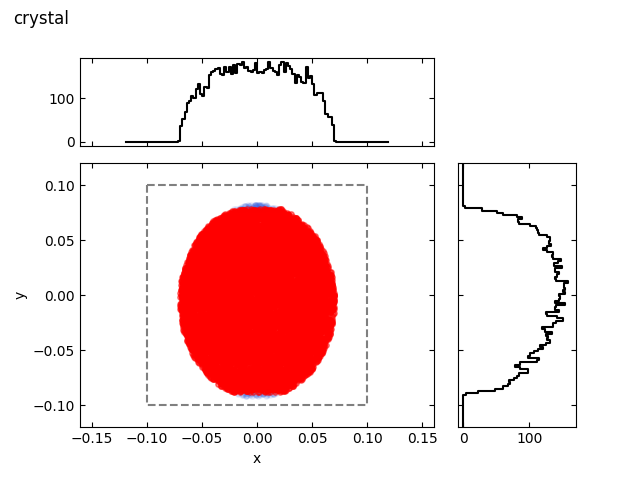

In [7]:
results = results_dict['XicsrtOpticToroidalCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'crystal', aspect='equal')

DEBUG:xicsrt: Yo mama was here.
DEBUG:xicsrt: num_a, num_b: 21, 11, total: 231
DEBUG:xicsrt: num_a, num_b: 11, 5, total: 55
DEBUG:xicsrt: WxH: 0.200x0.200
WARNI:xicsrt: Optic width (0.2000x0.2003)is not a multiple of the pixel_size (0.0020).May lead to truncation of output image.
DEBUG:xicsrt: Pixel grid size: 100 x 100
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
 INFO:xicsrt: Histogram bins, size:0.002003 num: 120
DEBUG:xicsrt: lost  crystal    126
DEBUG:xicsrt: found crystal    9874


<IPython.core.display.Javascript object>


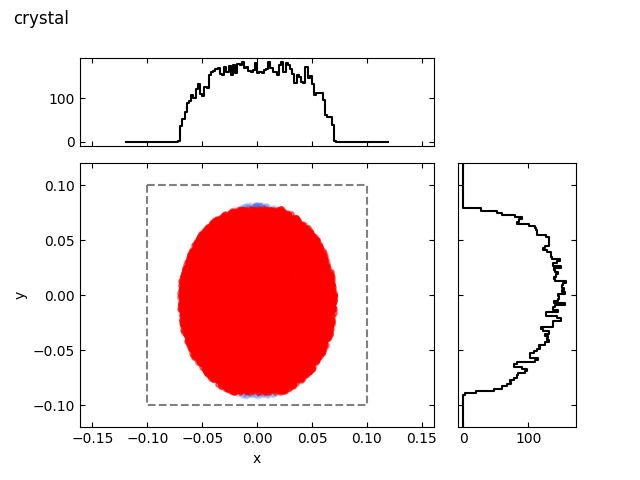

In [8]:
results = results_dict['XicsrtOpticMeshToroidalCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'crystal', aspect='equal')

DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Histogram bins, size:0.004000 num: 120
 INFO:xicsrt: Histogram bins, size:0.004000 num:  60
DEBUG:xicsrt: lost  detector   126
DEBUG:xicsrt: found detector   9874


<IPython.core.display.Javascript object>


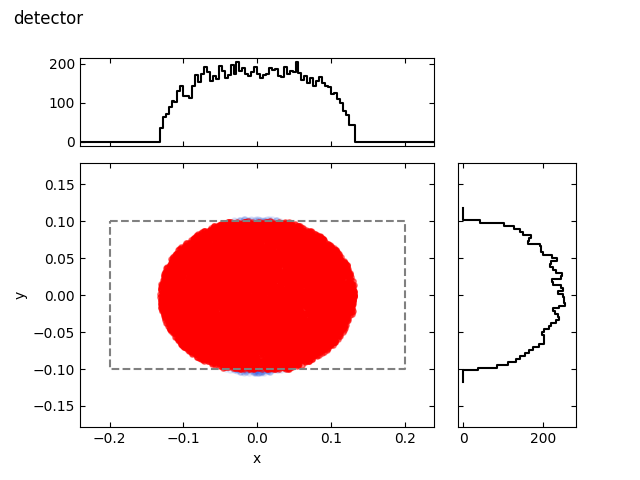

In [9]:
results = results_dict['XicsrtOpticToroidalCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'detector', aspect='equal')

DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Histogram bins, size:0.004000 num: 120
 INFO:xicsrt: Histogram bins, size:0.004000 num:  60
DEBUG:xicsrt: lost  detector   126
DEBUG:xicsrt: found detector   9874


<IPython.core.display.Javascript object>


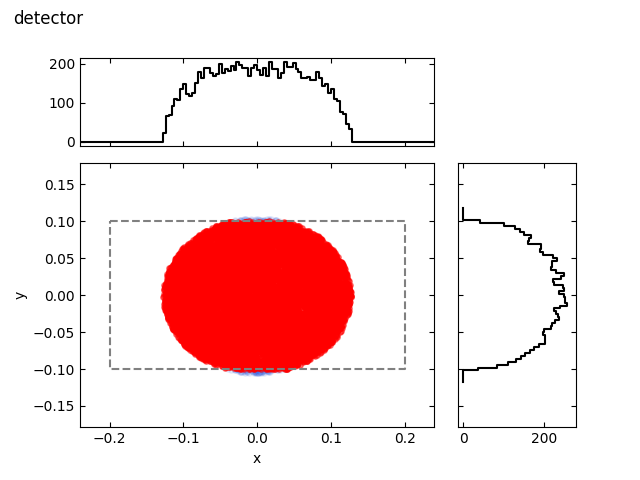

In [10]:
results = results_dict['XicsrtOpticMeshToroidalCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'detector', aspect='equal')

DEBUG:xicsrt: Pixel grid size: 100 x 100
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
DEBUG:xicsrt: lost  crystal    1763
DEBUG:xicsrt: found crystal    8237


<IPython.core.display.Javascript object>


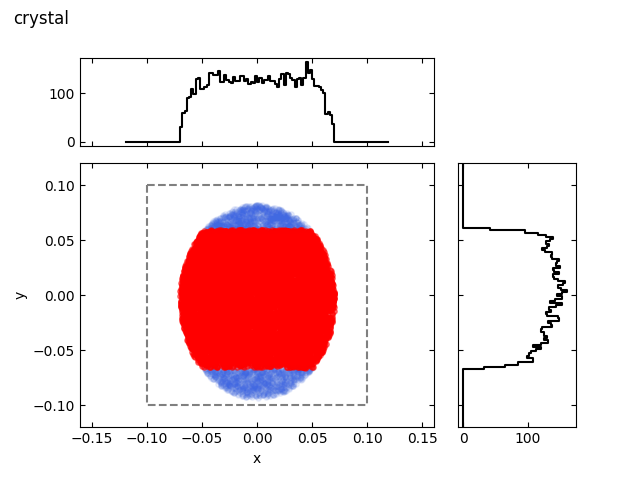

In [11]:
results = results_dict['XicsrtOpticCylindricalCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'crystal', aspect='equal')

DEBUG:xicsrt: Pixel grid size: 100 x 100
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
 INFO:xicsrt: Histogram bins, size:0.002000 num: 120
DEBUG:xicsrt: lost  crystal    1773
DEBUG:xicsrt: found crystal    8227


<IPython.core.display.Javascript object>


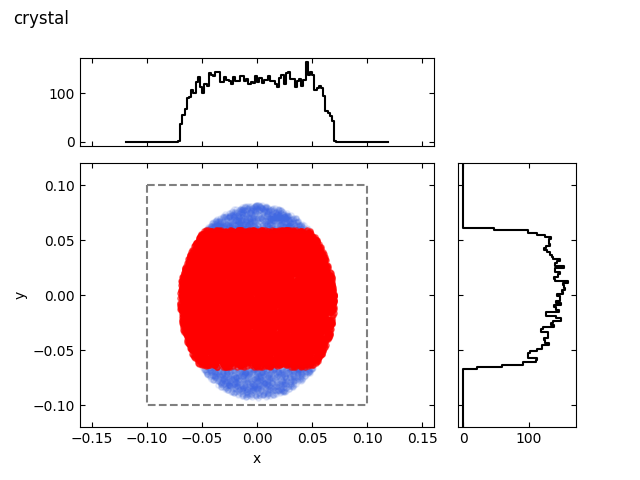

In [12]:
results = results_dict['XicsrtOpticPlanarCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'crystal', aspect='equal')

DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Histogram bins, size:0.004000 num: 120
 INFO:xicsrt: Histogram bins, size:0.004000 num:  60
DEBUG:xicsrt: lost  detector   1763
DEBUG:xicsrt: found detector   8237


<IPython.core.display.Javascript object>


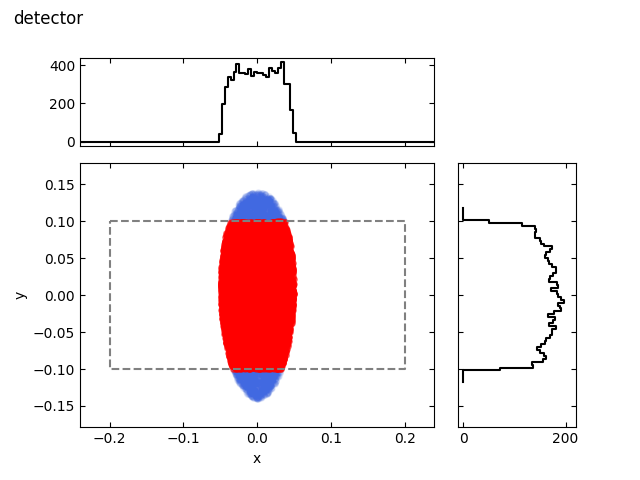

In [13]:
results = results_dict['XicsrtOpticCylindricalCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'detector', aspect='equal')

DEBUG:xicsrt: Pixel grid size: 100 x 50
 INFO:xicsrt: Histogram bins, size:0.004000 num: 120
 INFO:xicsrt: Histogram bins, size:0.004000 num:  60
DEBUG:xicsrt: lost  detector   1773
DEBUG:xicsrt: found detector   8227


<IPython.core.display.Javascript object>


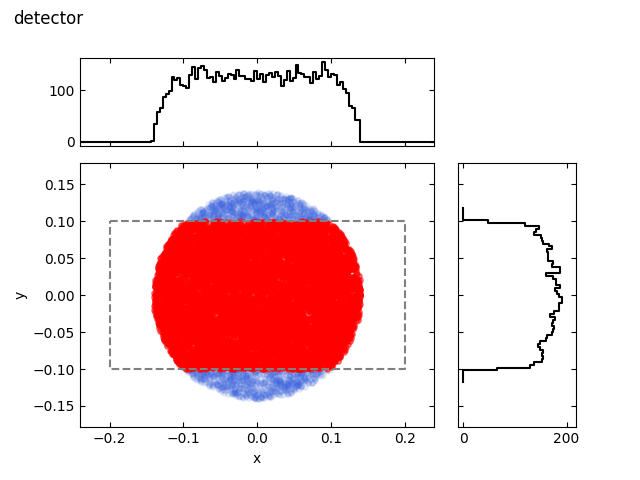

In [14]:
results = results_dict['XicsrtOpticPlanarCrystal']
import xicsrt.visual.xicsrt_2d__matplotlib as xicsrt_2d
fig = xicsrt_2d.plot_intersect(results, 'detector', aspect='equal')

In [15]:
import xicsrt.visual.xicsrt_3d__plotly as xicsrt_3d

results = results_dict['XicsrtOpticCylindricalCrystal']

fig = xicsrt_3d.figure()
xicsrt_3d.add_rays(results)
xicsrt_3d.add_optics(results['config'])
xicsrt_3d.add_sources(results['config'])
xicsrt_3d.show()

DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50


In [16]:
import xicsrt.visual.xicsrt_3d__plotly as xicsrt_3d

results = results_dict['XicsrtOpticToroidalCrystal']

fig = xicsrt_3d.figure()
xicsrt_3d.add_rays(results)
xicsrt_3d.add_optics(results['config'])
xicsrt_3d.add_sources(results['config'])
xicsrt_3d.show()

DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50


In [17]:
import xicsrt.visual.xicsrt_3d__plotly as xicsrt_3d

results = results_dict['XicsrtOpticMeshToroidalCrystal']

fig = xicsrt_3d.figure()
xicsrt_3d.add_rays(results)
xicsrt_3d.add_optics(results['config'])
xicsrt_3d.add_sources(results['config'])
xicsrt_3d.show()

DEBUG:xicsrt: Yo mama was here.
DEBUG:xicsrt: num_a, num_b: 21, 11, total: 231
DEBUG:xicsrt: num_a, num_b: 11, 5, total: 55
DEBUG:xicsrt: WxH: 0.200x0.200
WARNI:xicsrt: Optic width (0.2000x0.2003)is not a multiple of the pixel_size (0.0020).May lead to truncation of output image.
DEBUG:xicsrt: Pixel grid size: 100 x 100
DEBUG:xicsrt: Pixel grid size: 100 x 50
